# Introduction

This project addresses a binary classification problem: predicting whether a credit card client will default on their payment in the next month. It uses the [Default of Credit Card Clients Dataset](https://www.kaggle.com/uciml/default-of-credit-card-clients-dataset), which contains 30,000 records and 24 features, including demographic information, payment history, and billing amounts from April to September 2005.

The target variable is default.payment.next.month, indicating whether the client defaulted. The remaining features provide monthly financial and repayment data that help inform this prediction task.

This dataset was originally featured in a [research study](https://www.sciencedirect.com/science/article/pii/S0957417407006719) comparing classification models for default prediction. Results in this project may be compared against findings from the paper.

In [ ]:
import pandas as pd
import altair_ally as aly
import matplotlib.pyplot as plt
import shap
from sklearn.model_selection import RandomizedSearchCV, cross_val_predict, cross_val_score, cross_validate, train_test_split
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.preprocessing import KBinsDiscretizer, OneHotEncoder, OrdinalEncoder, StandardScaler, PolynomialFeatures
from sklearn.impute import SimpleImputer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_selection import RFE, RFECV, SelectFromModel, SequentialFeatureSelector
from sklearn.metrics import (
    ConfusionMatrixDisplay,
    confusion_matrix,
    classification_report,
    PrecisionRecallDisplay,
    RocCurveDisplay,
    average_precision_score,
    roc_auc_score,
    precision_score,
    recall_score,
    f1_score,
)
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression, Ridge, RidgeCV, ElasticNetCV, LassoCV
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from scipy.stats import uniform, lognorm, loguniform, randint
from lightgbm.sklearn import LGBMClassifier
from sklearn.svm import LinearSVC
from xgboost import XGBClassifier
from sklearn.inspection import permutation_importance
from sklearn.model_selection import train_test_split

aly.alt.data_transformers.disable_max_rows()

# Data description

The columns `ID`, `LIMIT_BAL`, `SEX`, `EDUCATION`, `MARRIAGE`, and `AGE` are self-explanatory. Columns `PAY_0` to `PAY_6` indicate the repayment status for each month (-1 = paid duly, 1 = payment delayed by one month, 2 = payment delayed by two months, ..., 8 = payment delayed by eight months, and 9 = payment delayed by nine months or more), which are ordinary columns. Columns `BILL_AMT1` to `BILL_AMT6` represent the amount on the bill statement for each month. Columns `PAY_AMT1` to `PAY_AMT6` represent the amount of the previous payment for each month.

**Preliminary analysis**

- `PAY`, `BILL_AMT`, `PAY_AMT` creates an interesting problem for feature engineering. Should these be treated as individual months or some kind of time-series feature to spot trends within the 6 month period. 
- Each month has a different number of days. Do we need to look at the data on a per day basis? Does the granularity matter?
- Should we look at relative proportions instead? For example, `PAY_AMT`/`BILL_AMT` instead of the absolute value of `PAY_AMT`. 
- `Education` has 1 value for "others" and 2 different values for "unknown", is there a difference here?
- `PAY` shows delays for up to 9 months but our data only spans across 6 months. This means for customers who are 7-9 months late, we would have some additional insights in to their prior behaviour before the 6 months period but for others we would not.
- Should `AGE` be put in to age groups instead?
- Drop `SEX` because it's not appropriate to use gender as a basis to determine whether someone would default.
- The dataset only covers data for each month from April 2005 to September 2005, which is somewhat limited.
- All features are numeric.
- No missing values. Therefore we assume all customers have been at the bank for at least 6 months.
- There is a class imbalance in the TARGET column, which we will address in the following sections.

In [ ]:
df = pd.read_csv('data/UCI_Credit_Card.csv')

# Drop ID because it's a unique identifier. It is not useful as a predictor
df.drop(columns=['ID'], inplace = True)

# df.rename(columns={'default.payment.next.month' : 'DEFAULT', 'PAY_0' : 'PAY_1'}, inplace = True)

# Rename columns
df.rename(
    columns = {
        "default.payment.next.month": "TARGET",
        "PAY_0": "REPAY_STATUS_SEP",
        "PAY_2": "REPAY_STATUS_AUG",
        "PAY_3": "REPAY_STATUS_JUL",
        "PAY_4": "REPAY_STATUS_JUN",
        "PAY_5": "REPAY_STATUS_MAY",
        "PAY_6": "REPAY_STATUS_APR",
        "BILL_AMT1": "BILL_AMT_SEP",
        "BILL_AMT2": "BILL_AMT_AUG",
        "BILL_AMT3": "BILL_AMT_JUL",
        "BILL_AMT4": "BILL_AMT_JUN",
        "BILL_AMT5": "BILL_AMT_MAY",
        "BILL_AMT6": "BILL_AMT_APR",
        "PAY_AMT1": "PAY_AMT_SEP",
        "PAY_AMT2": "PAY_AMT_AUG",
        "PAY_AMT3": "PAY_AMT_JUL",
        "PAY_AMT4": "PAY_AMT_JUN",
        "PAY_AMT5": "PAY_AMT_MAY",
        "PAY_AMT6": "PAY_AMT_APR",
    }, 
    inplace = True
)

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   LIMIT_BAL         30000 non-null  float64
 1   SEX               30000 non-null  int64  
 2   EDUCATION         30000 non-null  int64  
 3   MARRIAGE          30000 non-null  int64  
 4   AGE               30000 non-null  int64  
 5   REPAY_STATUS_SEP  30000 non-null  int64  
 6   REPAY_STATUS_AUG  30000 non-null  int64  
 7   REPAY_STATUS_JUL  30000 non-null  int64  
 8   REPAY_STATUS_JUN  30000 non-null  int64  
 9   REPAY_STATUS_MAY  30000 non-null  int64  
 10  REPAY_STATUS_APR  30000 non-null  int64  
 11  BILL_AMT_SEP      30000 non-null  float64
 12  BILL_AMT_AUG      30000 non-null  float64
 13  BILL_AMT_JUL      30000 non-null  float64
 14  BILL_AMT_JUN      30000 non-null  float64
 15  BILL_AMT_MAY      30000 non-null  float64
 16  BILL_AMT_APR      30000 non-null  float6

Let's check if the dataset contains any null values.

In [4]:
print(df.isnull().sum())

LIMIT_BAL           0
SEX                 0
EDUCATION           0
MARRIAGE            0
AGE                 0
REPAY_STATUS_SEP    0
REPAY_STATUS_AUG    0
REPAY_STATUS_JUL    0
REPAY_STATUS_JUN    0
REPAY_STATUS_MAY    0
REPAY_STATUS_APR    0
BILL_AMT_SEP        0
BILL_AMT_AUG        0
BILL_AMT_JUL        0
BILL_AMT_JUN        0
BILL_AMT_MAY        0
BILL_AMT_APR        0
PAY_AMT_SEP         0
PAY_AMT_AUG         0
PAY_AMT_JUL         0
PAY_AMT_JUN         0
PAY_AMT_MAY         0
PAY_AMT_APR         0
TARGET              0
dtype: int64


Check if the target column is balanced.

In [5]:
df["TARGET"].value_counts()

TARGET
0    23364
1     6636
Name: count, dtype: int64

## Data splitting

Split the data into train and test portions.

In [7]:
train_df, test_df = train_test_split(df, test_size = 0.3, random_state = 123)

## Exploratory data analysis

Perform exploratory data analysis on the train set.

**Summary Statistics**
- REPAY_STATUS has a minimum of -2, which is outside the range of the data description. 

In [8]:
train_df.iloc[:,0:11].describe()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,REPAY_STATUS_SEP,REPAY_STATUS_AUG,REPAY_STATUS_JUL,REPAY_STATUS_JUN,REPAY_STATUS_MAY,REPAY_STATUS_APR
count,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000
mean,167880.651429,1.600762,1.852143,1.554000,35.500810,-0.015429,-0.137095,-0.171619,-0.225238,-0.264429,-0.295095
std,130202.682167,0.489753,0.792961,0.521675,9.212644,1.120465,1.194506,1.196123,1.168556,1.137205,1.147992
min,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000
25%,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
50%,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000


In [9]:
train_df.iloc[:,11:].describe()

,BILL_AMT_SEP,BILL_AMT_AUG,BILL_AMT_JUL,BILL_AMT_JUN,BILL_AMT_MAY,BILL_AMT_APR,PAY_AMT_SEP,PAY_AMT_AUG,PAY_AMT_JUL,PAY_AMT_JUN,PAY_AMT_MAY,PAY_AMT_APR,TARGET
count,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000,2.100000e+04,21000.000000,21000.000000,21000.000000,21000.000000,21000.000000
mean,51107.566762,49126.824810,47010.414095,43486.610905,40428.518333,38767.202667,5673.585143,5.895027e+03,5311.432286,4774.021381,4751.850095,5237.762190,0.223238
std,73444.143025,71400.032096,69035.759516,64843.303993,61187.200817,59587.689549,17033.241454,2.180143e+04,18377.997079,15434.136142,15228.193125,18116.846563,0.416427
min,-15308.000000,-67526.000000,-157264.000000,-50616.000000,-61372.000000,-339603.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3649.250000,2925.750000,2663.750000,2293.750000,1739.500000,1215.750000,1000.000000,8.200000e+02,390.000000,266.000000,234.000000,110.750000,0.000000
50%,22284.000000,21002.500000,20088.500000,19102.500000,18083.000000,16854.500000,2100.000000,2.007000e+03,1809.500000,1500.000000,1500.000000,1500.000000,0.000000
75%,66979.750000,63795.250000,59895.000000,54763.250000,50491.000000,49253.750000,5007.250000,5.000000e+03,4628.500000,4021.250000,4016.000000,4000.000000,0.000000
max,964511.000000,983931.000000,855086.000000,891586.000000,927171.000000,961664.000000,873552.000000,1.227082e+06,896040.000000,621000.000000,426529.000000,528666.000000,1.000000


**Correlation**
- We see `BILL_AMT` has a strong collinearity with the `BILL_AMT` from the prior months. Same with `REPAY_STATUS`. We may need to find a way to address the collinearity. 

In [10]:
aly.corr(train_df)

alt.ConcatChart(...)

**Distribution Visualization**
- Class imbalance with `TARGET`
- Proportion of defaults higher in 50+ age group
- Lower default with married vs single
- Even though `REPAY_STATUS` has a range from -2 to 9, most values cluster around  -2 to 2. 

In [11]:
aly.dist(train_df, 'TARGET', mark='bar')

alt.RepeatChart(...)

In [12]:
aly.dist(train_df, 'TARGET')

alt.ConcatChart(...)

# Feature engineering

**Added Features**
- `AGE_GROUP`: New column to use age groups instead of age since age is too granular
- `PRO_BAL`: New columns for balance owed as a proportion of their credit limit. A person who is spending close to their limit every month could be less likely to pay off their balance when compared to a person who spends only a fraction of their limit. 

In [13]:
# Create age groups instead of using age
age_bins = [21, 30, 40, 50, 60, 100]
age_labels = ['21-30', '31-40', '41-50', '51-60', '61+'] 
train_df['AGE_GROUP'] = pd.cut(train_df['AGE'], bins=age_bins, labels=age_labels, right=False)
test_df['AGE_GROUP'] = pd.cut(test_df['AGE'], bins=age_bins, labels=age_labels, right=False)

# Create new columns that contain proportion of balance relative to credit limit
train_df = train_df.assign(
    PROP_BAL_SEP = train_df['BILL_AMT_SEP'] / train_df['LIMIT_BAL'],
    PROP_BAL_AUG = train_df['BILL_AMT_AUG'] / train_df['LIMIT_BAL'],
    PROP_BAL_JUL = train_df['BILL_AMT_JUL'] / train_df['LIMIT_BAL'],
    PROP_BAL_JUN = train_df['BILL_AMT_JUN'] / train_df['LIMIT_BAL'],
    PROP_BAL_MAY = train_df['BILL_AMT_MAY'] / train_df['LIMIT_BAL'],
    PROP_BAL_APR = train_df['BILL_AMT_APR'] / train_df['LIMIT_BAL']
)

test_df = test_df.assign(
    PROP_BAL_SEP = test_df['BILL_AMT_SEP'] / test_df['LIMIT_BAL'],
    PROP_BAL_AUG = test_df['BILL_AMT_AUG'] / test_df['LIMIT_BAL'],
    PROP_BAL_JUL = test_df['BILL_AMT_JUL'] / test_df['LIMIT_BAL'],
    PROP_BAL_JUN = test_df['BILL_AMT_JUN'] / test_df['LIMIT_BAL'],
    PROP_BAL_MAY = test_df['BILL_AMT_MAY'] / test_df['LIMIT_BAL'],
    PROP_BAL_APR = test_df['BILL_AMT_APR'] / test_df['LIMIT_BAL']
)

In [14]:
X_train = train_df.drop(columns = 'TARGET')
y_train = train_df['TARGET']
X_test = test_df.drop(columns = 'TARGET')
y_test = test_df['TARGET']

# Preprocessing and transformations

In [15]:
numerical_features = ['PAY_AMT_SEP', 'PAY_AMT_AUG', 'PAY_AMT_JUL', 'PAY_AMT_JUN', 'PAY_AMT_MAY', 'PAY_AMT_APR', 'PROP_BAL_SEP',
                    'PROP_BAL_AUG', 'PROP_BAL_JUL', 'PROP_BAL_JUN', 'PROP_BAL_MAY','PROP_BAL_APR']
categorical_features = ['EDUCATION', 'MARRIAGE', 'REPAY_STATUS_SEP', 'REPAY_STATUS_AUG', 'REPAY_STATUS_JUL', 
                        'REPAY_STATUS_JUN', 'REPAY_STATUS_MAY', 'REPAY_STATUS_APR', 'AGE_GROUP']
drop_features = ['AGE', 'SEX', 'LIMIT_BAL', 'BILL_AMT_SEP', 'BILL_AMT_AUG', 'BILL_AMT_JUL', 'BILL_AMT_JUN', 'BILL_AMT_MAY', 'BILL_AMT_APR']

In [16]:
preprocessor = make_column_transformer(
    (StandardScaler(), numerical_features),
    (OneHotEncoder(handle_unknown='ignore'), categorical_features),
    ('drop', drop_features)
)

# Baseline model

### Dummy Baseline
- Since `DummyClassifier` predicts the most frequent class which is 0 (no payment default), there are no true positives and the f1 score is 0. 

In [17]:
dummy = make_pipeline(
    preprocessor, 
    DummyClassifier())

dummy.fit(X_train, y_train)
scoring_metrics = "f1"

cross_val_results = {}
cross_val_results['dummy'] = pd.DataFrame(cross_validate(dummy, X_train, y_train, scoring=scoring_metrics, return_train_score=True)).agg(['mean', 'std']).round(3).T
cross_val_results['dummy']

,mean,std
fit_time,0.018,0.006
score_time,0.005,0.001
test_score,0.000,0.000
train_score,0.000,0.000


### Linear models 

- With a linear model using LogisticRegression, we've achieved a f1 score of 0.47 with default parameters and 0.54 after hyperparameter optimization. This low score could be caused by non-linear relationships not captured by the model.
- The standard deviation of the score is fairly low so we know the score obtained isn't caused by a random lucky split.
- Optimized model uses `class_weight = balanced`, indicating the class imbalanced needs to be considered for our final model as well. 

In [18]:
# Source: Modified based off of DSCI 573 Lab 1 Solution
def score_with_metrics(models, preprocessor, scoring="f1"):
    """
    Return cross-validation scores for given models as a dataframe.

    Parameters
    ----------
    models : dict
        a dictionary with names and scikit-learn models
    scoring : list/dict/string
        scoring parameter values for cross-validation

    Returns
    ----------
    pd.DataFrame
        Dataframe containing scoring metrics for all models

    """
    results_df = {}
    for (name, model) in models.items():
        pipeline = make_pipeline(preprocessor, model)
        print(f"Scoring {name}...")
        scores = cross_validate(
            pipeline, X_train, y_train, return_train_score=True, scoring=scoring
        )
        df = pd.DataFrame(scores)
        results_df[name] = df.mean()
    print("Scoring complete.")
    return pd.DataFrame(results_df)

In [19]:
def perform_random_search(estimators, param_distributions, n_iter, scoring='f1'):
    """
    Perform RandomizedSearchCV for multiple models and return the best parameters for each model.
    
    Parameters
    ----------
    estimators : dict
        A dictionary where keys are esimators and values are estimators (models or pipelines)
    param_distributions : dict
        A dictionary where keys are model names (same as in `models`) and values are parameter distributions.
    n_iter : int
        Number of CV iterations
    scoring : str
        Scoring metric for evaluation. Default is 'f1'.
    n_iter : int
        Number of parameter settings sampled. Default is 20.
    
    Returns
    ----------
    pd.DataFrame
        Dataframe containing best parameters for all models
    """
    results = {}
    
    for name, estimator in estimators.items():
        print(f"Performing RandomizedSearchCV for {name}...")
        
        param_dist = param_distributions.get(name, {})
        random_search = RandomizedSearchCV(
            estimator=estimator,
            param_distributions=param_dist,
            n_iter=n_iter,
            scoring=scoring,
            n_jobs=-1,
            return_train_score=True 
        )
        random_search.fit(X_train, y_train)
        results[name] = {
            'fit_time': random_search.cv_results_['mean_fit_time'][random_search.best_index_],
            'score_time': random_search.cv_results_['mean_score_time'][random_search.best_index_],
            'test_score': random_search.cv_results_['mean_test_score'][random_search.best_index_],
            'test_score_std': random_search.cv_results_['std_test_score'][random_search.best_index_],
            'train_score': random_search.cv_results_['mean_train_score'][random_search.best_index_],
            'train_score_std': random_search.cv_results_['std_train_score'][random_search.best_index_],
            **random_search.best_params_
        }
    print("Search complete.")
    return pd.DataFrame(results)

In [20]:
logreg_results = score_with_metrics({'LogReg' : LogisticRegression(random_state=123, max_iter=1000)}, preprocessor, scoring=scoring_metrics)
logreg_results

Scoring LogReg...
Scoring complete.


,LogReg
fit_time,0.070154
score_time,0.005104
test_score,0.470791
train_score,0.475486


In [21]:
param_dist = { 'LogReg_Opt' : {
        'logisticregression__C': loguniform(1e-4, 1e4),
        'logisticregression__class_weight': [None, 'balanced']
    }
}

logreg = make_pipeline(
    preprocessor,
    LogisticRegression(random_state=123, max_iter=1000)
)

linear_search = perform_random_search({'LogReg_Opt': logreg}, param_dist, n_iter = 20, scoring=scoring_metrics)
linear_search

Performing RandomizedSearchCV for LogReg_Opt...
Search complete.


,LogReg_Opt
fit_time,0.141539
score_time,0.012269
test_score,0.537737
test_score_std,0.008299
train_score,0.540904
train_score_std,0.002272
logisticregression__C,0.273063
logisticregression__class_weight,balanced


### Nonlinear Models

- With 3 non-optimized, non-linear models, only 1 model (LGBM) achieved a f1 score close to the optimized LogisticRegression model.
- RandomForest took a significantly longer time to fit when compared to other models and it's also the slowest to score. The added computational time did not lead to better model performance. 
- With all 3 non-linear models, we see signs of overfitting, with RandomForest being the worst. 

In [22]:
models = {
    "RandomForest": RandomForestClassifier(random_state = 123, class_weight = "balanced"),
    "LGBM" : LGBMClassifier(random_state = 123, class_weight = "balanced", verbosity = -1),
    "XGB" : XGBClassifier(random_state = 123, scale_pos_weight=3)
}

In [23]:
nonlinear_results = score_with_metrics(models, preprocessor, scoring=scoring_metrics)

Scoring RandomForest...
Scoring LGBM...
Scoring XGB...
Scoring complete.


In [24]:
pd.merge(linear_search, nonlinear_results, left_index=True, right_index=True, how='inner').sort_values(by='test_score', axis=1, ascending=False)

,LGBM,LogReg_Opt,XGB,RandomForest
fit_time,0.331388,0.141539,0.170143,5.263128
score_time,0.010391,0.012269,0.009093,0.063881
test_score,0.537784,0.537737,0.511432,0.470101
train_score,0.663081,0.540904,0.805722,0.970006


# Feature selection

### Feature Selection - Linear Model
- For `LogisticRegression`, feature selection was performed using L1 regularization.
- The regularization did not reduced the number of features. `n_features` remain at 92.  
- This resulted in approximately the same performance (0.54 vs 0.53). 

In [25]:
l1_pipe = make_pipeline(
    preprocessor,
    LogisticRegression(penalty='l1', 
                       class_weight='balanced',
                       C=0.004795,
                       solver='liblinear', 
                       max_iter=20_000)
)

scores = cross_validate(l1_pipe, X_train, y_train, return_train_score=True, scoring=scoring_metrics)
l1_pipe.fit(X_train, y_train)
pd.DataFrame(scores)['test_score'].mean()

pd.DataFrame({'LogReg' :  {'test_score': pd.DataFrame(scores)['test_score'].mean(),
                           'n_features': len(l1_pipe[-1].coef_[0])}})

,LogReg
test_score,0.528995
n_features,92.000000


In [26]:
# Source: Modified based off of DSCI 573 Lab 1 Solution
def feature_selection_with_metrics(models, preprocessor, feature_selector, scoring='f1'):
    """
    Return cross-validation scores and n_features selected for given models as a dataframe.

    Parameters
    ----------
    models : dict
        a dictionary with names and scikit-learn models
    preprocessor: sklearn pipe or estimator
        preprocessor for the model
    feature_selector : sklearn estimator
        estimator to use for feature selection
    scoring : string
        scoring parameter values for cross-validation

    Returns
    ----------
    pd.DataFrame
        Dataframe containing scoring metrics and n_features for all models

    """
    results = {}
    for (name, model) in models.items():
        pipeline = make_pipeline(preprocessor, feature_selector, model)
        print(f"Feature selecting for {name}...")
        scores = cross_validate(
            pipeline, X_train, y_train, return_train_score=True, scoring=scoring
        )
        pipeline.fit(X_train, y_train)
        results[name] = {'test_score': pd.DataFrame(scores)['test_score'].mean(),
                         'n_features': pipeline[1].n_features_
                        }

    print("Feature selection complete.")
    return pd.DataFrame(results)

**Feature Selection - Nonlinear Models**
- Feature selection was performed using Recursive Feature Elimination with `ExtraTreesClassifier` as the feature selector.
- This method reduced the number of features significantly but the f1 score remains approximately the same (+/- 1%) as previously.
- The number of features did decrease significantly from 92 to 11. This would help make the model less complex without sacrificing performance.
- The computational time for the feature selection was about 10 minutes per model, even with reduced `n_estimators` and `max_features`. This time would multiply with hyperparameter optimization so we will not include feature selection in our pipeline. 

- Failed Attempts due to unreasonable computation time :
    - Before the above sucessed attempts, we experimented feature selection with `RandomForestClassifier()` as our classifer.
    - We use `SequentialFeatureSelector(direction="forward")` with both `Ridge()` and `RandomForestRegressor` as feature importance estimator.
    - Even with `max_feature` set to only 10, SFS takes >10 minutes to run Because the number of features after preprocessor is 92, resulting in iterations SFS fits (92 + 91 + 90 +... ) models, which is quite a lot and in total we will fit around 90 models..
    - After switching to `RFECV(Ridge())`, it takes reasonable time to run, however, the model performance didn't improve.

In [28]:
# This code block may take time to run (30+ mins)
feature_selector = RFECV(
    ExtraTreesClassifier(
        random_state=123, 
        n_estimators=10, 
        max_depth=20,
        n_jobs=-1,
        max_features='sqrt'
    )
)
#feature_selection_with_metrics(models, preprocessor, feature_selector, scoring=scoring_metrics)

# Hyperparameter optimization

- After hyperparameter optimization, we are on-par with the performance of the optimized linear model in terms of f1 score (0.53 ~ 0.54) but still not exceeding it.
- RandomForest and XGB still has significant overfitting. 

In [29]:
param_distributions = {
    'RandomForest_Opt': {
        'randomforestclassifier__n_estimators': [10, 20, 30, 50, 80],
        'randomforestclassifier__class_weight': ['balanced', 'balanced_subsample', None],
        'randomforestclassifier__min_samples_split': [2, 5, 8, 10, 15],
        'randomforestclassifier__max_depth': randint(5,30)
    },
    'LGBM_Opt': {
        "lgbmclassifier__learning_rate": [0.01, 0.1, 0.3],
        "lgbmclassifier__max_bin": [100, 255, 500],
        "lgbmclassifier__num_leaves": [31, 50, 70],
        "lgbmclassifier__class_weight": [None, "balanced"]
    },
    'XGB_Opt': {
        'xgbclassifier__n_estimators': [100, 200, 300, 400],  
        'xgbclassifier__max_depth': [3, 5, 7, 10],           
        'xgbclassifier__learning_rate': [0.01, 0.05, 0.1, 0.2],  
        'xgbclassifier__subsample': [0.6, 0.8, 1.0],        
        'xgbclassifier__colsample_bytree': [0.6, 0.8, 1.0],  
        'xgbclassifier__scale_pos_weight': [1, 2, 5, 10]  
    }
}   

estimators = {
    'RandomForest_Opt': make_pipeline(
        preprocessor,
        RandomForestClassifier(random_state = 123)
    ),
    'LGBM_Opt': make_pipeline(
        preprocessor,
        LGBMClassifier(random_state = 123, verbosity = -1)
    ),
    'XGB_Opt': make_pipeline(
        preprocessor,
        XGBClassifier(random_state = 123)
    )
}

In [30]:
search = perform_random_search(estimators, param_distributions, n_iter = 20, scoring=scoring_metrics)

Performing RandomizedSearchCV for RandomForest_Opt...
Performing RandomizedSearchCV for LGBM_Opt...
Performing RandomizedSearchCV for XGB_Opt...
Search complete.


In [31]:
nonlinear_search = search.sort_values(by='test_score', axis=1, ascending=False)
nonlinear_search

,RandomForest_Opt,LGBM_Opt,XGB_Opt
fit_time,2.497735,4.562215,0.407815
score_time,0.042411,0.049828,0.044101
test_score,0.546777,0.542849,0.533686
test_score_std,0.012712,0.00958,0.012075
train_score,0.730446,0.606512,0.622747
train_score_std,0.00242,0.004838,0.004286
randomforestclassifier__class_weight,balanced,NaN,NaN
randomforestclassifier__max_depth,16,NaN,NaN
randomforestclassifier__min_samples_split,15,NaN,NaN
randomforestclassifier__n_estimators,50,NaN,NaN


# Interpretation and feature importances

Use the methods we saw in class (e.g., permutation_importance or shap) (or any other methods of your choice) to examine the most important features of one of the non-linear models.

In [32]:
best_pipe = make_pipeline(
    preprocessor,
    LGBMClassifier(
        random_state=123, 
        verbosity=-1,
        num_leaves=70,
        max_bin=255,
        learning_rate=0.1,
        class_weight='balanced'
    )
)

In [33]:
best_pipe.fit(X_train, y_train)

result = permutation_importance(
    best_pipe,
    X_train, 
    y_train,
    random_state=123,
    n_repeats=10,
    n_jobs=-1,
    scoring=scoring_metrics
)

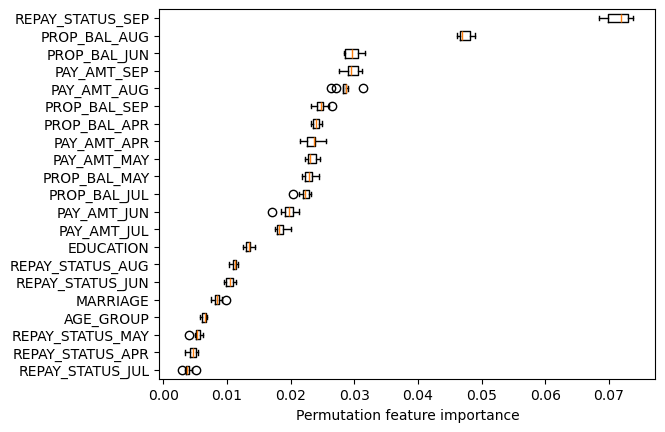

In [34]:
# Source: DSCI 573 Lecture 8 Notes

X_train_perm = X_train.drop(columns=drop_features)
result = permutation_importance(best_pipe, X_train_perm, y_train, n_repeats=10, random_state=123)
perm_sorted_idx = result.importances_mean.argsort()
plt.boxplot(
    result.importances[perm_sorted_idx].T,
    vert=False,
    tick_labels=X_train_perm.columns[perm_sorted_idx],
)
plt.xlabel('Permutation feature importance')
plt.show()

**Interpretation of Feature Importance**

- Using our best model, the most important feature is `REPAY_STATUS_SEP`. It makes sense that the customer's payment status last month will be the biggest predictor of whether they will pay next month. If we go one further back to `REPAY_STATUS_AUG` and the previous months, the importance drops a lot. Indicating historical repayment status is not as important.
- However historical data on the actual payment `PAY_AMT` and balance `PROP_BAL` are useful predictors for whether a customer would default. Other social information such as marriage and age group are not important predictors for default. 

# Results on the test set

In [35]:
accurancy_score_train = best_pipe.score(X_train, y_train)
accurancy_score_test = best_pipe.score(X_test, y_test)
print("Accurancy score on train data: ", round(accurancy_score_train, 2))
print("Accurancy score on test data: ", round(accurancy_score_test, 2))

y_pred = best_pipe.predict(X_test)
f1_score_test = f1_score(y_test, y_pred, average='binary') 
print("F1 score on test data: ", round(f1_score_test, 2))

Accurancy score on train data:  0.87
Accurancy score on test data:  0.77
F1 score on test data:  0.53


In [36]:
pd.merge(linear_search, nonlinear_search, left_index=True, right_index=True, how='inner').sort_values(by='test_score', axis=1, ascending=False)

,RandomForest_Opt,LGBM_Opt,LogReg_Opt,XGB_Opt
fit_time,2.497735,4.562215,0.141539,0.407815
score_time,0.042411,0.049828,0.012269,0.044101
test_score,0.546777,0.542849,0.537737,0.533686
test_score_std,0.012712,0.00958,0.008299,0.012075
train_score,0.730446,0.606512,0.540904,0.622747
train_score_std,0.00242,0.004838,0.002272,0.004286


**Final Model**

The Logistic Regression model demonstrates stable performance, with both train and test F1 scores around 0.54. In contrast, the Random Forest model shows potential overfitting, with a high train score of 0.97 but a lower test score of 0.47. The LightGBM model exhibits moderate generalizability, with train and test scores of 0.66 and 0.537, respectively. XGBoost, however, shows signs of overfitting, with a train score of 0.73 and a test score of 0.46. Hyperparameter optimization provided minimal improvement in F1 scores for these models. 

We choose LightGBM as the best model with optimized hyperparameters, as it achieves a slightly higher validation score compared to the Logistic Regression model and demonstrates stable performance on unseen data. 

**Optimization Bias**

The test F1 score of 0.526 is consistent with the validation score. The accuracy score on the training data is 0.868, and the accuracy score on the test data is 0.767, which shows signs of overfitting.

Although cross validation was used to minimize optimization bias, only optimizing for f1 score could lead to bias in our model. There are signs of this in our model given accuracy was not optimized and shows a lot more overfitting then in our f1 score. 

A better approach would be using a combination of scoring metrics for hyperparameter optimization and evaluation. This won't necessary improve the scoring of our model but would make our model generalize better. 

In [37]:
ohe_feature_names = (
    best_pipe.named_steps["columntransformer"]
    .named_transformers_["onehotencoder"]
    .get_feature_names_out(categorical_features)
    .tolist()
)

feature_names = numerical_features + ohe_feature_names

X_train_enc = pd.DataFrame(
    data=preprocessor.transform(X_train).toarray(),
    columns=feature_names,
    index=X_train.index,
)

In [38]:
lgbm_explainer = shap.TreeExplainer(
    best_pipe.named_steps['lgbmclassifier'],
)
lgbm_explanation = lgbm_explainer(X_train_enc)

In [39]:
lgbm_explainer.expected_value

np.float64(-0.6579284098762689)

Predicted value for the 3rd row in the training data:  1


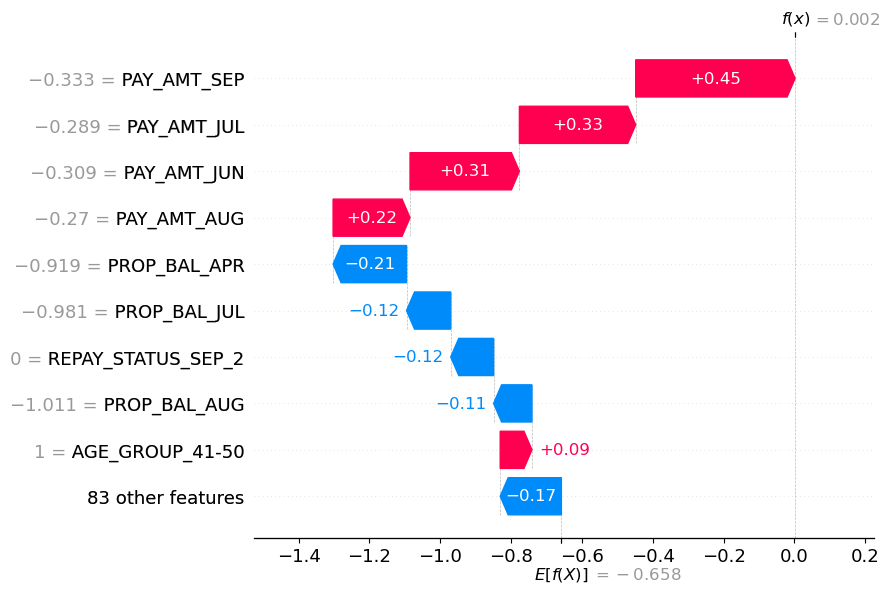

In [40]:
# Example for predicted target = 1, the person will default
print("Predicted value for the 3rd row in the training data: ", best_pipe.named_steps["lgbmclassifier"].predict(X_train_enc)[2])
shap.plots.waterfall(lgbm_explanation[2, :])

**SHAP Example: Positive Prediction**

The above SHAP plot shows an example of how predictions are made. The `expected_value` from our final model is -0.66. Using this as the threshold, predictiong above the threshold would be a positive prediction (customer defaults) and predictions below the threshold would a negative prediction (no default). 

For an example of a positive case, we see PAY_AMT as the largest predictors of whether a customer would default. The `PAY_AMT` values shown have been rescaled by StandardScaler() so they are not the actual pay amount from the customer. But we can see in general negative values below -0.27 are considered positive predicators for whether a customer would default. 

As we saw in our EDA, higher age groups also tend to have more defaults and this is captured in this example where `AGE_GROUP_51-50 = 1` is considered a positive indicator for default. More discussion would be required to assess whether judging someone by their age is appropriate. 

Predicted value for the 106th row in the training data:  0


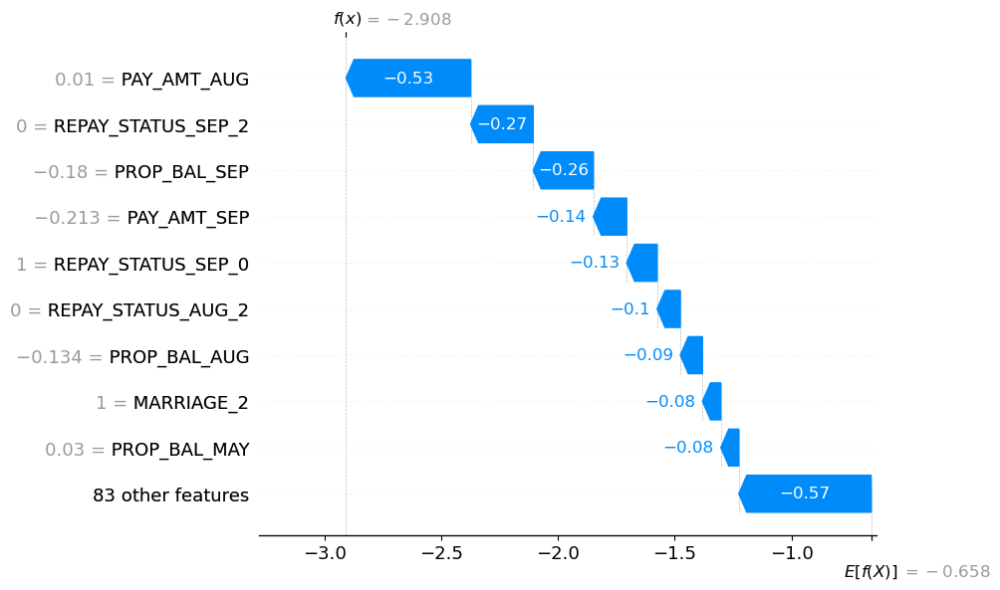

In [41]:
# Example for predicted target = 0, the person will not default
print("Predicted value for the 106th row in the training data: ", best_pipe.named_steps["lgbmclassifier"].predict(X_train_enc)[105])
shap.plots.waterfall(lgbm_explanation[105, :])

**SHAP Example - Negative Prediction**

In contrast to the positive case, we can see that `PAY_AMT` above the -0.27 threshold are considered negative indicators. This makes sense since customers who pay off their balance more are less likely to default. In addition, `REPAY_STATUS_SEP` is also a much large predicator in terms of magnitude when compared to the positive example.

# Summary of results

Overall our model achieved moderate results at predicting whether a customer would default on credit card payments.
1. **F1 score = 0.53** is moderate. It is quite a harmonic mean of precision and recall, suggesting the model is balancing the false negative and false positive equally. 
2. **Recall score = 0.59**, higher than our f1 score. The model identifies about 60% of customers who will actually default. Since the bank will care about default payment more, there's still a lot of space for improvement.
3. **Precision = 0.47**. Of all customers flagged, only 47% actually default. This indicates a high false alarm rate by our model's prediction. 
4. **Overall Accuracy=0.77** It is a moderately good results but not the best. Since there's class imbalance, we do have to sacrifice some accuracy in exchange true positive.
5. **True negative rate:** 0.64/(0.64 + 0.15) ≈  81%. Our model correctly identifies 81.4% of customers who will pay on time, which is good for the bank, because the bank won't have to flag reliable customers unnecessarily and waste too much on rick control costs.

Business Implications:  
- Recall score suggests the model is missing about 40% of actual defaults. This could be costly for bank.
- About 15% customers were incorrectly flagged as defaulters. Bank might cast some unnecessary restrictions for reliable customers who might actually purchase more and pay duly.

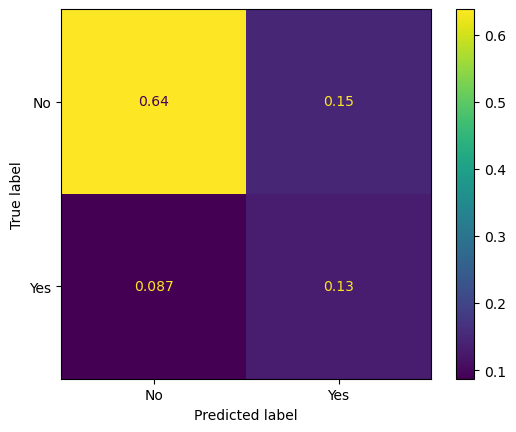

In [42]:
cm = ConfusionMatrixDisplay.from_estimator(
    best_pipe,
    X_test,
    y_test,
    display_labels=['No', 'Yes'],
    normalize='all'
)

In [43]:
round(pd.DataFrame(
    {
        'f1' : [f1_score_test],
        'recall' : [recall_score(y_test, y_pred)],
        'precision' : [precision_score(y_test, y_pred)],
        'accuracy' : [accurancy_score_test]
    }, index=['Score']), 2)

,f1,recall,precision,accuracy
Score,0.53,0.6,0.47,0.77


**Ideas for Improvement**
- From `permutation_importance`, `REPAY_STATUS` was not contributing a lot as a predictor and was making the model more complex due to the OneHotEncoder having to add ~10 columns for every `REPAY_STATUS` month we include. Dropping these feature and only keeping the most recent month would help make the models less complex.
- Feature selection took up a lot of computational time and we had to reduce `n_estimators` and `max_features` for the feature selector in order to make the process manageable. Dropping more features during pre-processing would allow us to use more robust values for the feature selector while also reducing fit time.
- LightGBM and XGBoost models have built in L1 regularizations that could be used for feature selection.
- Threshold assessment to determine if the default threshold is appropriate or it can be improved. Consider adjusting the classification threshold for positive class, if the bank aims to catch more default payments.
- Trying `PolynomialFeatures()` or interactions for feature engineering to see if performance improves.
- Due the time constraints, we did not try averaging different classifiers or using stacking techniques.